## 여기부터 복붙해서 사용

In [ ]:
data = pd.read_csv('/content/drive/Shareddrives/🥑PSAT_DM_2728🥑/Dataset/기사크롤링_TFIDF/경제&사회_20211020_TFIDF.csv', encoding = 'utf-8')

In [ ]:
data['clean_words_gensim'] = data['clean_words'].apply(lambda k: eval(''.join(k)))

In [ ]:
data["clean_words_gensim"]

0       [뉴욕, 뉴욕, 증권, 거래소, 자산운용, 사, 프로, 셰어, 시미, 하이먼, 최고...
1       [비트코인, 개당, ETF, 데뷔, 후, 최고, 뛰어넘어, 비트코인, 가격, 넘으며...
2       [오전, 선물, 흐름, 그렇고, 숨, 고르기에, 들어간, 모습, 입니다, 본격, 어...
3       [인민, 은행, 이강, 행, 기한, 맞은, 채권, 이자, 연달, 지급, 채무불이행,...
4       [뉴욕, 증권, 거래소, 강민경, 뉴욕증시, 상승세, 출발, 다우존스, 산업, 평균...
                              ...                        
3038    [러시아, 인도, 펀드, 고공, 행진, 개월새, 에너지, 강세, 부진, 흔들리는, ...
3039    [동부, 오전, 개장, 대형, 내놓은, 실적, 대체로, 시장, 예상, 넘어서면서, ...
3040    [디, 피씨, PEF, 운용, 사, 스틱, 흡수, 합병, 결정, 자산, 육박, PE...
3041    [자체, 분, 매입, 마, 이스터, PE, 분, 콜, 옵션, 확보, 하이파, 킹, ...
3042    [사모펀드, PEF, 운용, 사, MBK, 파트너, 스, 인수, 라이프, 스타일, ...
Name: clean_words_gensim, Length: 3043, dtype: object

In [ ]:
import pandas as pd
import numpy as np
import re
# import coredottext.nlp as nlp
import json
import warnings
# import pyLDAvis.gensim
from gensim.models.coherencemodel import CoherenceModel
from gensim.models.ldamodel import LdaModel
from gensim.corpora.dictionary import Dictionary
from gensim import corpora
import time

In [ ]:
# 문서를 사전 형식으로 만들기
tokenized_doc=data["clean_words_gensim"]
dictionary = corpora.Dictionary(tokenized_doc)
corpus = [dictionary.doc2bow(text) for text in tokenized_doc]
# 두번째 뉴스 결과 출력: (단어의 정수, 단어의 빈도 수)
print(corpus[1])

[(0, 6), (2, 6), (3, 2), (6, 1), (7, 2), (19, 1), (23, 1), (31, 13), (34, 3), (36, 3), (37, 1), (38, 1), (39, 1), (40, 1), (47, 1), (53, 1), (54, 3), (58, 1), (60, 1), (66, 5), (70, 1), (71, 2), (72, 1), (73, 3), (74, 1), (79, 1), (80, 1), (81, 1), (82, 1), (83, 1), (84, 1), (85, 1), (86, 2), (87, 1), (88, 1), (89, 1), (90, 1), (91, 2), (92, 1), (93, 1), (94, 1), (95, 1), (96, 3), (97, 2), (98, 1), (99, 2), (100, 1), (101, 1), (102, 1), (103, 1), (104, 1), (105, 1), (106, 1), (107, 1), (108, 1), (109, 1), (110, 1), (111, 3), (112, 1), (113, 1), (114, 3), (115, 1), (116, 2), (117, 1), (118, 1), (119, 2), (120, 1), (121, 1), (122, 1), (123, 6), (124, 1), (125, 1), (126, 1), (127, 1), (128, 1), (129, 1), (130, 1), (131, 1), (132, 1), (133, 1), (134, 1), (135, 3), (136, 1), (137, 1), (138, 1), (139, 1), (140, 1), (141, 1), (142, 1), (143, 1), (144, 1), (145, 1), (146, 1), (147, 1), (148, 3), (149, 2), (150, 1), (151, 1), (152, 1), (153, 1), (154, 1), (155, 4), (156, 1)]


In [ ]:
# coherences: 상위 단어들간 유사도: 해당주제와 얼마나 의미론적으로 일치하는 단어들이 모여있는지.
# perplexity: 혼란도: 실제로 관측되는 값을 얼마나 잘 예측하는지. 작을수록 좋음!
# coherence를 두단어간 조합으로 검사를 하되, 한 단어가 다른 단어와 다른 문서들에서 얼마나 많이 쓰였는지 frequency를 검사.
coherences=[]
perplexities=[]
passes=[]
# warnings.filterwarnings('ignore')
# passes tuning
for i in range(10):
    ntopics, nwords = 30, 1000
    if i==0:
        p=1
    else:
        p=i*5
    passes.append(p)
    tic = time.time()
    lda4 = LdaModel(corpus, id2word=dictionary, num_topics=ntopics, iterations=400, passes=p)
    print('epoch',p,time.time() - tic)

    cm = CoherenceModel(model=lda4, corpus=corpus, coherence='u_mass')
    coherence = cm.get_coherence()
    print("Coherence",coherence)
    coherences.append(coherence)
    print('Perplexity: ', lda4.log_perplexity(corpus),'\n\n')
    perplexities.append(lda4.log_perplexity(corpus))

/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(Elogthetad + Elogbeta[:, int(id)]) for id, cnt in doc)
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(Elogthetad + Elogbeta[:, int(id)]) for id, cnt in doc)
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(Elogthetad + Elogbeta[:, int(id)]) for

epoch 1 15.226048946380615
Coherence -3.2538515362185287


스트리밍 출력 내용이 길어서 마지막 5000줄이 삭제되었습니다.
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(Elogthetad + Elogbeta[:, int(id)]) for id, cnt in doc)
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(Elogthetad + Elogbeta[:, int(id)]) for id, cnt in doc)
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(El

Perplexity:  -8.497646992877236 




스트리밍 출력 내용이 길어서 마지막 5000줄이 삭제되었습니다.
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(Elogthetad + Elogbeta[:, int(id)]) for id, cnt in doc)
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(Elogthetad + Elogbeta[:, int(id)]) for id, cnt in doc)
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(El

epoch 5 36.38679504394531
Coherence -3.1694683174650438


스트리밍 출력 내용이 길어서 마지막 5000줄이 삭제되었습니다.
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(Elogthetad + Elogbeta[:, int(id)]) for id, cnt in doc)
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(Elogthetad + Elogbeta[:, int(id)]) for id, cnt in doc)
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(El

Perplexity:  -7.9689428710045735 




스트리밍 출력 내용이 길어서 마지막 5000줄이 삭제되었습니다.
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(Elogthetad + Elogbeta[:, int(id)]) for id, cnt in doc)
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(Elogthetad + Elogbeta[:, int(id)]) for id, cnt in doc)
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(El

epoch 10 61.09717059135437
Coherence -3.9535708946847516


스트리밍 출력 내용이 길어서 마지막 5000줄이 삭제되었습니다.
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(Elogthetad + Elogbeta[:, int(id)]) for id, cnt in doc)
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(Elogthetad + Elogbeta[:, int(id)]) for id, cnt in doc)
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(El

Perplexity:  -7.890509750296629 




스트리밍 출력 내용이 길어서 마지막 5000줄이 삭제되었습니다.
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(Elogthetad + Elogbeta[:, int(id)]) for id, cnt in doc)
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(Elogthetad + Elogbeta[:, int(id)]) for id, cnt in doc)
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(El

epoch 15 83.67717790603638
Coherence -3.9655678064946405


스트리밍 출력 내용이 길어서 마지막 5000줄이 삭제되었습니다.
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(Elogthetad + Elogbeta[:, int(id)]) for id, cnt in doc)
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(Elogthetad + Elogbeta[:, int(id)]) for id, cnt in doc)
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(El

Perplexity:  -7.843016730872065 




스트리밍 출력 내용이 길어서 마지막 5000줄이 삭제되었습니다.
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(Elogthetad + Elogbeta[:, int(id)]) for id, cnt in doc)
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(Elogthetad + Elogbeta[:, int(id)]) for id, cnt in doc)
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(El

epoch 20 109.57317447662354
Coherence -3.4575260277379516


스트리밍 출력 내용이 길어서 마지막 5000줄이 삭제되었습니다.
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(Elogthetad + Elogbeta[:, int(id)]) for id, cnt in doc)
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(Elogthetad + Elogbeta[:, int(id)]) for id, cnt in doc)
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(El

Perplexity:  -7.855579957720636 




스트리밍 출력 내용이 길어서 마지막 5000줄이 삭제되었습니다.
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(Elogthetad + Elogbeta[:, int(id)]) for id, cnt in doc)
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(Elogthetad + Elogbeta[:, int(id)]) for id, cnt in doc)
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(El

epoch 25 134.08911967277527
Coherence -4.054022144037917


스트리밍 출력 내용이 길어서 마지막 5000줄이 삭제되었습니다.
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(Elogthetad + Elogbeta[:, int(id)]) for id, cnt in doc)
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(Elogthetad + Elogbeta[:, int(id)]) for id, cnt in doc)
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(El

Perplexity:  -7.876136406000278 




스트리밍 출력 내용이 길어서 마지막 5000줄이 삭제되었습니다.
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(Elogthetad + Elogbeta[:, int(id)]) for id, cnt in doc)
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(Elogthetad + Elogbeta[:, int(id)]) for id, cnt in doc)
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(El

epoch 30 160.47871160507202
Coherence -4.1365342634226145


스트리밍 출력 내용이 길어서 마지막 5000줄이 삭제되었습니다.
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(Elogthetad + Elogbeta[:, int(id)]) for id, cnt in doc)
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(Elogthetad + Elogbeta[:, int(id)]) for id, cnt in doc)
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(El

Perplexity:  -7.85086962308125 




스트리밍 출력 내용이 길어서 마지막 5000줄이 삭제되었습니다.
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(Elogthetad + Elogbeta[:, int(id)]) for id, cnt in doc)
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(Elogthetad + Elogbeta[:, int(id)]) for id, cnt in doc)
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(El

epoch 35 190.4865825176239
Coherence -3.791026566505579


스트리밍 출력 내용이 길어서 마지막 5000줄이 삭제되었습니다.
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(Elogthetad + Elogbeta[:, int(id)]) for id, cnt in doc)
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(Elogthetad + Elogbeta[:, int(id)]) for id, cnt in doc)
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(El

Perplexity:  -7.862203755691732 




스트리밍 출력 내용이 길어서 마지막 5000줄이 삭제되었습니다.
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(Elogthetad + Elogbeta[:, int(id)]) for id, cnt in doc)
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(Elogthetad + Elogbeta[:, int(id)]) for id, cnt in doc)
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(El

epoch 40 216.6520380973816
Coherence -3.770132746683447


스트리밍 출력 내용이 길어서 마지막 5000줄이 삭제되었습니다.
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(Elogthetad + Elogbeta[:, int(id)]) for id, cnt in doc)
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(Elogthetad + Elogbeta[:, int(id)]) for id, cnt in doc)
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(El

Perplexity:  -7.848494356329285 




스트리밍 출력 내용이 길어서 마지막 5000줄이 삭제되었습니다.
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(Elogthetad + Elogbeta[:, int(id)]) for id, cnt in doc)
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(Elogthetad + Elogbeta[:, int(id)]) for id, cnt in doc)
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(El

epoch 45 246.9370584487915
Coherence -3.4487441364489086


스트리밍 출력 내용이 길어서 마지막 5000줄이 삭제되었습니다.
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(Elogthetad + Elogbeta[:, int(id)]) for id, cnt in doc)
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(Elogthetad + Elogbeta[:, int(id)]) for id, cnt in doc)
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(El

Perplexity:  -7.832590943012899 




스트리밍 출력 내용이 길어서 마지막 5000줄이 삭제되었습니다.
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(Elogthetad + Elogbeta[:, int(id)]) for id, cnt in doc)
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(Elogthetad + Elogbeta[:, int(id)]) for id, cnt in doc)
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(El

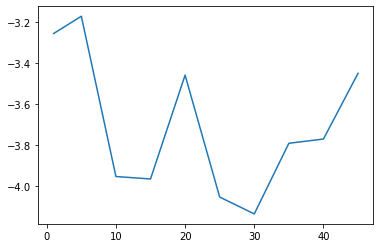

In [ ]:
import matplotlib.pyplot as plt
plt.plot(passes,coherences)
plt.show()

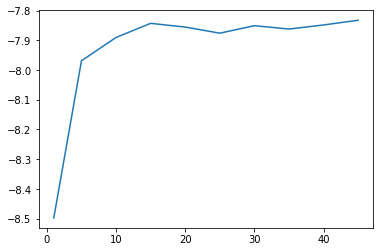

In [ ]:
plt.plot(passes,perplexities)
plt.show()  

In [ ]:
coherencesT=[]
perplexitiesT=[]
numtopic=[]
# warnings.filterwarnings('ignore')

for i in range(10):
    if i==0:
        ntopics = 2
    else:
        ntopics = 10*i
    nwords = 100
    numtopic.append(ntopics)
    tic = time.time()
    # 위 그래프에서 찾은 최적의 Passes 값을 넣어주세요
    lda4 = LdaModel(corpus, id2word=dictionary, num_topics=ntopics, iterations=400, passes=20)
    print('ntopics',ntopics,time.time() - tic)

    cm = CoherenceModel(model=lda4, corpus=corpus, coherence='u_mass')
    coherence = cm.get_coherence()
    print("Cpherence",coherence)
    coherencesT.append(coherence)
    print('Perplexity: ', lda4.log_perplexity(corpus),'\n\n')
    perplexitiesT.append(lda4.log_perplexity(corpus))

스트리밍 출력 내용이 길어서 마지막 5000줄이 삭제되었습니다.
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(Elogthetad + Elogbeta[:, int(id)]) for id, cnt in doc)
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(Elogthetad + Elogbeta[:, int(id)]) for id, cnt in doc)
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(El

ntopics 2 83.11653661727905
Cpherence -1.4818245978454898


스트리밍 출력 내용이 길어서 마지막 5000줄이 삭제되었습니다.
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(Elogthetad + Elogbeta[:, int(id)]) for id, cnt in doc)
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(Elogthetad + Elogbeta[:, int(id)]) for id, cnt in doc)
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(El

Perplexity:  -8.446971073586463 




스트리밍 출력 내용이 길어서 마지막 5000줄이 삭제되었습니다.
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(Elogthetad + Elogbeta[:, int(id)]) for id, cnt in doc)
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(Elogthetad + Elogbeta[:, int(id)]) for id, cnt in doc)
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(El

ntopics 10 76.81537961959839
Cpherence -2.3536179313514


스트리밍 출력 내용이 길어서 마지막 5000줄이 삭제되었습니다.
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(Elogthetad + Elogbeta[:, int(id)]) for id, cnt in doc)
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(Elogthetad + Elogbeta[:, int(id)]) for id, cnt in doc)
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(El

Perplexity:  -8.138305133311047 




스트리밍 출력 내용이 길어서 마지막 5000줄이 삭제되었습니다.
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(Elogthetad + Elogbeta[:, int(id)]) for id, cnt in doc)
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(Elogthetad + Elogbeta[:, int(id)]) for id, cnt in doc)
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(El

ntopics 20 85.64324188232422
Cpherence -3.4420878038653306


스트리밍 출력 내용이 길어서 마지막 5000줄이 삭제되었습니다.
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(Elogthetad + Elogbeta[:, int(id)]) for id, cnt in doc)
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(Elogthetad + Elogbeta[:, int(id)]) for id, cnt in doc)
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(El

Perplexity:  -7.985946051398945 




스트리밍 출력 내용이 길어서 마지막 5000줄이 삭제되었습니다.
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(Elogthetad + Elogbeta[:, int(id)]) for id, cnt in doc)
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(Elogthetad + Elogbeta[:, int(id)]) for id, cnt in doc)
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(El

ntopics 30 108.00960636138916
Cpherence -3.6147750320109493


스트리밍 출력 내용이 길어서 마지막 5000줄이 삭제되었습니다.
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(Elogthetad + Elogbeta[:, int(id)]) for id, cnt in doc)
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(Elogthetad + Elogbeta[:, int(id)]) for id, cnt in doc)
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(El

Perplexity:  -7.862112044267115 




스트리밍 출력 내용이 길어서 마지막 5000줄이 삭제되었습니다.
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(Elogthetad + Elogbeta[:, int(id)]) for id, cnt in doc)
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(Elogthetad + Elogbeta[:, int(id)]) for id, cnt in doc)
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(El

ntopics 40 178.96576023101807
Cpherence -3.6847024369396


스트리밍 출력 내용이 길어서 마지막 5000줄이 삭제되었습니다.
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(Elogthetad + Elogbeta[:, int(id)]) for id, cnt in doc)
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(Elogthetad + Elogbeta[:, int(id)]) for id, cnt in doc)
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(El

Perplexity:  -7.797598946047733 




스트리밍 출력 내용이 길어서 마지막 5000줄이 삭제되었습니다.
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(Elogthetad + Elogbeta[:, int(id)]) for id, cnt in doc)
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(Elogthetad + Elogbeta[:, int(id)]) for id, cnt in doc)
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(El

ntopics 50 166.12394499778748
Cpherence -4.414654547494149


스트리밍 출력 내용이 길어서 마지막 5000줄이 삭제되었습니다.
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(Elogthetad + Elogbeta[:, int(id)]) for id, cnt in doc)
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(Elogthetad + Elogbeta[:, int(id)]) for id, cnt in doc)
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(El

Perplexity:  -7.7402437410607465 




스트리밍 출력 내용이 길어서 마지막 5000줄이 삭제되었습니다.
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(Elogthetad + Elogbeta[:, int(id)]) for id, cnt in doc)
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(Elogthetad + Elogbeta[:, int(id)]) for id, cnt in doc)
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(El

ntopics 60 180.23455381393433
Cpherence -4.05014142783118


스트리밍 출력 내용이 길어서 마지막 5000줄이 삭제되었습니다.
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(Elogthetad + Elogbeta[:, int(id)]) for id, cnt in doc)
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(Elogthetad + Elogbeta[:, int(id)]) for id, cnt in doc)
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(El

Perplexity:  -7.70547225397502 




스트리밍 출력 내용이 길어서 마지막 5000줄이 삭제되었습니다.
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(Elogthetad + Elogbeta[:, int(id)]) for id, cnt in doc)
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(Elogthetad + Elogbeta[:, int(id)]) for id, cnt in doc)
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(El

ntopics 70 217.01551485061646
Cpherence -4.452717385001179


스트리밍 출력 내용이 길어서 마지막 5000줄이 삭제되었습니다.
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(Elogthetad + Elogbeta[:, int(id)]) for id, cnt in doc)
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(Elogthetad + Elogbeta[:, int(id)]) for id, cnt in doc)
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(El

Perplexity:  -7.655754316246646 




스트리밍 출력 내용이 길어서 마지막 5000줄이 삭제되었습니다.
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(Elogthetad + Elogbeta[:, int(id)]) for id, cnt in doc)
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(Elogthetad + Elogbeta[:, int(id)]) for id, cnt in doc)
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(El

ntopics 80 432.34320974349976
Cpherence -4.707492274507246


스트리밍 출력 내용이 길어서 마지막 5000줄이 삭제되었습니다.
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(Elogthetad + Elogbeta[:, int(id)]) for id, cnt in doc)
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(Elogthetad + Elogbeta[:, int(id)]) for id, cnt in doc)
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(El

Perplexity:  -7.967811578063197 




스트리밍 출력 내용이 길어서 마지막 5000줄이 삭제되었습니다.
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(Elogthetad + Elogbeta[:, int(id)]) for id, cnt in doc)
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(Elogthetad + Elogbeta[:, int(id)]) for id, cnt in doc)
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(El

ntopics 90 533.0048983097076
Cpherence -4.447711283957648


스트리밍 출력 내용이 길어서 마지막 5000줄이 삭제되었습니다.
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(Elogthetad + Elogbeta[:, int(id)]) for id, cnt in doc)
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(Elogthetad + Elogbeta[:, int(id)]) for id, cnt in doc)
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(El

Perplexity:  -8.958973926635734 




스트리밍 출력 내용이 길어서 마지막 5000줄이 삭제되었습니다.
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(Elogthetad + Elogbeta[:, int(id)]) for id, cnt in doc)
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(Elogthetad + Elogbeta[:, int(id)]) for id, cnt in doc)
/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1077: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  score += np.sum(cnt * logsumexp(El

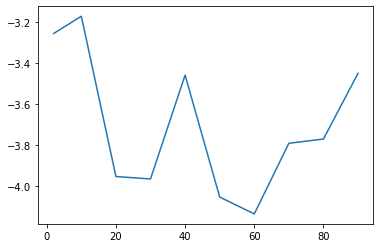

In [ ]:
# 그래프 그리기
import matplotlib.pyplot as plt
plt.plot(numtopic,coherences)
plt.show()

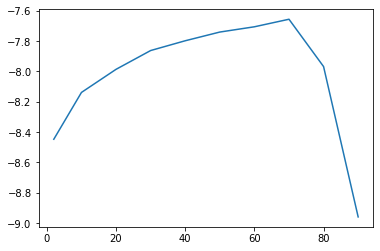

In [ ]:
import matplotlib.pyplot as plt
plt.plot(numtopic,perplexitiesT)
plt.show()

In [ ]:
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.decomposition import LatentDirichletAllocation

#LDA 는 Count기반의 Vectorizer만 적용 
count_vectorizer = CountVectorizer(max_df=0.1, max_features=1000, min_df=1, ngram_range=(1,2))

feat_vect = count_vectorizer.fit_transform(data.clean_words)
print('CountVectorizer Shape:', feat_vect.shape)

CountVectorizer Shape: (3043, 1000)


In [ ]:
from sklearn.decomposition import LatentDirichletAllocation, TruncatedSVD
from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer
from sklearn.model_selection import GridSearchCV
from pprint import pprint

# 위에서 찾은 토픽 개수를 n_components에 넣어주세요
# 다른 건 바꾸지 마세요
lda = LatentDirichletAllocation(n_components = 40, max_iter = 10, learning_decay = 0.9, random_state = 42)
lda.fit(feat_vect)

LatentDirichletAllocation(batch_size=128, doc_topic_prior=None,
                          evaluate_every=-1, learning_decay=0.9,
                          learning_method='batch', learning_offset=10.0,
                          max_doc_update_iter=100, max_iter=10,
                          mean_change_tol=0.001, n_components=40, n_jobs=None,
                          perp_tol=0.1, random_state=42, topic_word_prior=None,
                          total_samples=1000000.0, verbose=0)

In [ ]:
# Plotting tools
import pyLDAvis
import pyLDAvis.sklearn
import matplotlib.pyplot as plt
%matplotlib inline

In [ ]:
import pyLDAvis.sklearn  # sklearn의 ldamodel에 최적화된 라이브러리

pyLDAvis.enable_notebook()
vis = pyLDAvis.sklearn.prepare(lda, feat_vect, count_vectorizer)
pyLDAvis.display(vis)

/usr/local/lib/python3.7/dist-packages/pyLDAvis/_prepare.py:247: FutureWarning: In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only
  by='saliency', ascending=False).head(R).drop('saliency', 1)


In [ ]:
def show_topics(vectorizer, lda_model, n_words):
    keywords = np.array(vectorizer.get_feature_names())
    topic_keywords = []
    for topic_weights in lda_model.components_:
        top_keyword_locs = (-topic_weights).argsort()[:n_words]
        topic_keywords.append(keywords.take(top_keyword_locs))
    return topic_keywords

topic_keywords = show_topics(vectorizer=count_vectorizer, lda_model=lda, n_words=15)        

# Topic - Keywords Dataframe
df_topic_keywords = pd.DataFrame(topic_keywords)
df_topic_keywords.columns = ['Word '+str(i) for i in range(df_topic_keywords.shape[1])]
df_topic_keywords.index = ['Topic '+str(i) for i in range(1, df_topic_keywords.shape[0]+1)]
df_topic_keywords

,Word 0,Word 1,Word 2,Word 3,Word 4,Word 5,Word 6,Word 7,Word 8,Word 9,Word 10,Word 11,Word 12,Word 13,Word 14
Topic 1,솔루션,에너지,lg,에너지 솔루션,lg 에너지,배터리,과정,프라,국민은행,학과,인재,인력,인수,kb,융합
Topic 2,협약,협회,체결,금융 상품,업무 협약,업무,선박,소비자,자율,케이,스마트,공시,채용,협력,방법
Topic 3,오른,포인트,외국인,매수,매도,강세,마쳤다,상승세,종목,전일,거래 대비,올랐다,개인,연속,오른 거래
Topic 4,소재,수출,국산,항공,전시회,첨단,국제,전시,참가,미래,해외,신흥,분야,kai,수입
Topic 5,백신,접종,발사,누리,우주,백신 접종,한화,스페이스,위성,방역,러시아,위드,위드 코로나,회복,완료
Topic 6,바이오,치료,발행,채권,소재,환자,조성,조달,신약,시험,친환경,물질,그린,주택,시설
Topic 7,기능,디자인,테크,페이스북,시스템,메타,버스,메타 버스,세대,소비자,시대,변화,데이터,공간,사용자
Topic 8,영상,제보,국채,언론,화제,또는,공감,있다고 판단,상부,판단 되는,소중한,적극 반영,독자,하겠습니다,보내주시면 적극
Topic 9,롯데,행사,카드,할인,결제,백화점,신세계,구매,수수료,브랜드,매장,이마트,해외,가맹,혜택
Topic 10,선정,kt,차량,안전,gv,주행,suv,모터,트렌드,대한항공,사업자,공사,의무,성능,독점


In [ ]:
# 문서별 토픽 할당

doc_topic = lda.transform(feat_vect)

doc_per_topic_list = []
for n in range(doc_topic.shape[0]):
  topic_most_pr = doc_topic[n].argmax() +1
  topic_pr = doc_topic[n].max()
  doc_per_topic_list.append([n, topic_most_pr, topic_pr])

doc_topic_df = pd.DataFrame(doc_per_topic_list, columns = ['Doc_Num', 'Topic', 'Percentage'])

In [ ]:
data['topic'] = doc_topic_df['Topic']
data['Percentage'] = doc_topic_df['Percentage']

In [ ]:
# 저장하는 파일명 잘 확인

df_topic_keywords.to_csv('/content/drive/Shareddrives/🥑PSAT_DM_2728🥑/Dataset/토픽모델링2/경제&사회_20211020_Topics.csv', index = False, encoding = 'utf-8')
data.to_csv('/content/drive/Shareddrives/🥑PSAT_DM_2728🥑/Dataset/토픽모델링2/경제&사회_20211020_Allocation.csv', index = False, encoding = 'utf-8')

In [1]:
# ! pip install pyLDAvis
! pip install pyLDAvis
from google.colab import drive

drive.mount('/content/drive')

# 최초 1회 돌리면 오류가 뜰겁니다
# 에러 창에서 Restart Runtime 버튼 누르세요
# 버튼 누르고 난 후에 다시 실행하면 됩니다.

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [2]:
import pandas as pd
import numpy as np

## 여기부터 복붙해서 사용

In [ ]:
data = pd.read_csv('/content/drive/Shareddrives/🥑PSAT_DM_2728🥑/Dataset/기사크롤링_TFIDF/경제&사회_20211018_TFIDF.csv', encoding = 'utf-8')

In [ ]:
data['clean_words_gensim'] = data['clean_words'].apply(lambda k: eval(''.join(k)))

In [ ]:
data["clean_words_gensim"]

0       [위린, 시진핑, 국가주석, 산시성, 위린시, 쑤, 현, 중학교, 방문, 청소년, ...
1       [산업, 생산, 전월, 대비, 감소, 했다고, 준비, 제도, Fed, 준, 발표, ...
2       [동부, 오전, 개장, 여러, 지표, 움직임, 살펴보면, 미, 국채, 수익률, 거래...
3       [뉴욕, 둔화, 대한, 우려, 일단, 반락, 출발, 국내총생산, GDP, 시장, 예...
4       [매컨, 조, 바이든, 대통령, 미, 펜실베이니아주, 매컨지, 있는, 대형, 트럭,...
                              ...                        
2756    [현재, 업계, 자율, 일괄, 청약, 증거, 금, 정해져, 규정, 바꿀, 필요, 없...
2757    [선, 했던, 사흘, 연속, 대, 연초, 축소, 완만, 상승세, 이지현, 선, 회복...
2758    [개는, 정기예금, 수익, 우량, 묻지마, 추격, 매수, 빚투, 자제, 평가, 발굴...
2759    [K, 콘텐츠, 강화, 혜주, 부각, 달, 급등, 이콘, 목표, 상향, 오는, 글로...
2760    [국내, 증권사, 추천, 주로, 친환경, 정책, 수혜, 체감, 있는, 한화, 솔루션...
Name: clean_words_gensim, Length: 2761, dtype: object

In [ ]:
import pandas as pd
import numpy as np
import re
# import coredottext.nlp as nlp
import json
import warnings
# import pyLDAvis.gensim
from gensim.models.coherencemodel import CoherenceModel
from gensim.models.ldamodel import LdaModel
from gensim.corpora.dictionary import Dictionary
from gensim import corpora
import time

In [ ]:
# 문서를 사전 형식으로 만들기
tokenized_doc=data["clean_words_gensim"]
dictionary = corpora.Dictionary(tokenized_doc)
corpus = [dictionary.doc2bow(text) for text in tokenized_doc]
# 두번째 뉴스 결과 출력: (단어의 정수, 단어의 빈도 수)
print(corpus[1])

[(0, 1), (100, 1), (101, 1), (102, 1), (103, 1), (104, 1), (105, 1), (106, 1), (107, 2), (108, 1), (109, 1), (110, 1), (111, 1), (112, 1), (113, 1), (114, 1), (115, 1), (116, 1), (117, 1), (118, 1), (119, 1), (120, 1), (121, 1), (122, 4), (123, 1), (124, 7), (125, 1), (126, 1), (127, 2), (128, 1), (129, 1), (130, 1), (131, 1), (132, 1), (133, 1), (134, 1), (135, 1), (136, 2), (137, 1), (138, 1), (139, 1), (140, 1), (141, 1), (142, 3), (143, 1), (144, 1), (145, 2), (146, 1), (147, 1), (148, 1), (149, 1), (150, 1), (151, 2), (152, 1)]


In [ ]:
# coherences: 상위 단어들간 유사도: 해당주제와 얼마나 의미론적으로 일치하는 단어들이 모여있는지.
# perplexity: 혼란도: 실제로 관측되는 값을 얼마나 잘 예측하는지. 작을수록 좋음!
# coherence를 두단어간 조합으로 검사를 하되, 한 단어가 다른 단어와 다른 문서들에서 얼마나 많이 쓰였는지 frequency를 검사.
coherences=[]
perplexities=[]
passes=[]
# warnings.filterwarnings('ignore')
# passes tuning
for i in range(10):
    ntopics, nwords = 30, 1000
    if i==0:
        p=1
    else:
        p=i*5
    passes.append(p)
    tic = time.time()
    lda4 = LdaModel(corpus, id2word=dictionary, num_topics=ntopics, iterations=400, passes=p)
    print('epoch',p,time.time() - tic)

    cm = CoherenceModel(model=lda4, corpus=corpus, coherence='u_mass')
    coherence = cm.get_coherence()
    print("Coherence",coherence)
    coherences.append(coherence)
    print('Perplexity: ', lda4.log_perplexity(corpus),'\n\n')
    perplexities.append(lda4.log_perplexity(corpus))

epoch 1 13.622900247573853
Coherence -4.2342055094561415
Perplexity:  -8.469457401720637 


epoch 5 28.11185622215271
Coherence -4.297189651586778
Perplexity:  -7.9503527289620814 


epoch 10 44.98977565765381
Coherence -3.984625614678787
Perplexity:  -7.868401484870673 


epoch 15 60.56834864616394
Coherence -4.270244660211164
Perplexity:  -7.8669686343732455 


epoch 20 76.34026288986206
Coherence -4.379150231008494
Perplexity:  -7.855344084818237 


epoch 25 91.34047842025757
Coherence -3.820863705642259
Perplexity:  -7.844964515215904 


epoch 30 107.06269407272339
Coherence -4.552536826709133
Perplexity:  -7.8467006111638264 


epoch 35 122.4829113483429
Coherence -3.8780231314470828
Perplexity:  -7.831471904048584 


epoch 40 137.4027533531189
Coherence -4.34962488687762
Perplexity:  -7.8362834345301 


epoch 45 154.4084165096283
Coherence -3.709463720951759
Perplexity:  -7.831534614488904 




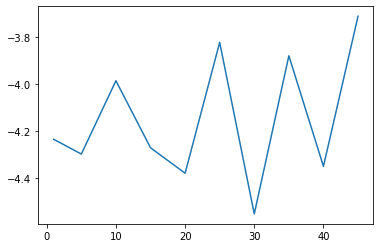

In [ ]:
import matplotlib.pyplot as plt
plt.plot(passes,coherences)
plt.show()

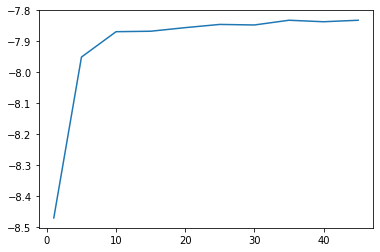

In [ ]:
plt.plot(passes,perplexities)
plt.show()  

In [ ]:
coherencesT=[]
perplexitiesT=[]
numtopic=[]
# warnings.filterwarnings('ignore')

for i in range(10):
    if i==0:
        ntopics = 2
    else:
        ntopics = 10*i
    nwords = 100
    numtopic.append(ntopics)
    tic = time.time()
    # 위 그래프에서 찾은 최적의 Passes 값을 넣어주세요
    lda4 = LdaModel(corpus, id2word=dictionary, num_topics=ntopics, iterations=400, passes=25)
    print('ntopics',ntopics,time.time() - tic)

    cm = CoherenceModel(model=lda4, corpus=corpus, coherence='u_mass')
    coherence = cm.get_coherence()
    print("Cpherence",coherence)
    coherencesT.append(coherence)
    print('Perplexity: ', lda4.log_perplexity(corpus),'\n\n')
    perplexitiesT.append(lda4.log_perplexity(corpus))

ntopics 2 56.888103723526
Cpherence -1.4821922589993664
Perplexity:  -8.401444844522794 


ntopics 10 58.39225459098816
Cpherence -2.748412079185864
Perplexity:  -8.118964426367786 


ntopics 20 68.99360680580139
Cpherence -3.3388825654810055
Perplexity:  -7.947745875918242 


ntopics 30 91.49382066726685
Cpherence -4.0233441175892715
Perplexity:  -7.838277925150442 


ntopics 40 151.77385592460632
Cpherence -4.105587908327273
Perplexity:  -7.772470203520395 


ntopics 50 132.15341997146606
Cpherence -4.91501592153763
Perplexity:  -7.7087103543599715 


ntopics 60 138.52996134757996
Cpherence -4.295872245438209
Perplexity:  -7.648890805135465 


ntopics 70 161.69116640090942
Cpherence -4.284233531146634
Perplexity:  -7.6179241158180435 


ntopics 80 349.93627166748047
Cpherence -4.360913873828733
Perplexity:  -7.749361235296758 


ntopics 90 411.0903100967407
Cpherence -4.37389558166446
Perplexity:  -8.538473195810802 




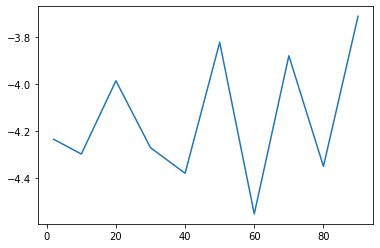

In [ ]:
# 그래프 그리기
import matplotlib.pyplot as plt
plt.plot(numtopic,coherences)
plt.show()

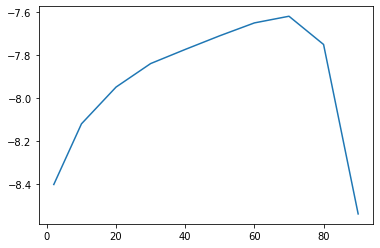

In [ ]:
import matplotlib.pyplot as plt
plt.plot(numtopic,perplexitiesT)
plt.show()

In [ ]:
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.decomposition import LatentDirichletAllocation

#LDA 는 Count기반의 Vectorizer만 적용 
count_vectorizer = CountVectorizer(max_df=0.1, max_features=1000, min_df=1, ngram_range=(1,2))

feat_vect = count_vectorizer.fit_transform(data.clean_words)
print('CountVectorizer Shape:', feat_vect.shape)

CountVectorizer Shape: (2761, 1000)


In [ ]:
from sklearn.decomposition import LatentDirichletAllocation, TruncatedSVD
from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer
from sklearn.model_selection import GridSearchCV
from pprint import pprint

# 위에서 찾은 토픽 개수를 n_components에 넣어주세요
# 다른 건 바꾸지 마세요
lda = LatentDirichletAllocation(n_components = 50, max_iter = 10, learning_decay = 0.9, random_state = 42)
lda.fit(feat_vect)

LatentDirichletAllocation(batch_size=128, doc_topic_prior=None,
                          evaluate_every=-1, learning_decay=0.9,
                          learning_method='batch', learning_offset=10.0,
                          max_doc_update_iter=100, max_iter=10,
                          mean_change_tol=0.001, n_components=50, n_jobs=None,
                          perp_tol=0.1, random_state=42, topic_word_prior=None,
                          total_samples=1000000.0, verbose=0)

In [ ]:
# Plotting tools
import pyLDAvis
import pyLDAvis.sklearn
import matplotlib.pyplot as plt
%matplotlib inline

/usr/local/lib/python3.7/dist-packages/past/types/oldstr.py:5: DeprecationWarning: Using or importing the ABCs from 'collections' instead of from 'collections.abc' is deprecated since Python 3.3,and in 3.9 it will stop working
  from collections import Iterable


In [ ]:
import pyLDAvis.sklearn  # sklearn의 ldamodel에 최적화된 라이브러리

pyLDAvis.enable_notebook()
vis = pyLDAvis.sklearn.prepare(lda, feat_vect, count_vectorizer)
pyLDAvis.display(vis)

/usr/local/lib/python3.7/dist-packages/pyLDAvis/_prepare.py:247: FutureWarning: In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only
  by='saliency', ascending=False).head(R).drop('saliency', 1)


In [ ]:
def show_topics(vectorizer, lda_model, n_words):
    keywords = np.array(vectorizer.get_feature_names())
    topic_keywords = []
    for topic_weights in lda_model.components_:
        top_keyword_locs = (-topic_weights).argsort()[:n_words]
        topic_keywords.append(keywords.take(top_keyword_locs))
    return topic_keywords

topic_keywords = show_topics(vectorizer=count_vectorizer, lda_model=lda, n_words=15)        

# Topic - Keywords Dataframe
df_topic_keywords = pd.DataFrame(topic_keywords)
df_topic_keywords.columns = ['Word '+str(i) for i in range(df_topic_keywords.shape[1])]
df_topic_keywords.index = ['Topic '+str(i) for i in range(1, df_topic_keywords.shape[0]+1)]
df_topic_keywords

,Word 0,Word 1,Word 2,Word 3,Word 4,Word 5,Word 6,Word 7,Word 8,Word 9,Word 10,Word 11,Word 12,Word 13,Word 14
Topic 1,롯데,카드,소비,백화점,신청,캐시,구매,회원,매장,위드,마트,위드 코로나,지급,대형,행사
Topic 2,한화,지뢰,esg,경영,안전,한화 시스템,esg 경영,엔진,활동,협약,양산,스타트업,손해,상생,창업
Topic 3,청약,공모,싸이월드,에스,상장,등급,주택,해지,자연,결정,kt,공정,수가,대응,장비
Topic 4,게임,넷플릭스,교육,스튜디오,콘텐츠,오징어,오징어 게임,중소기업,제작,드라마,대만,흥행,급등,교보,중소
Topic 5,채권,청년,일자리,캠코,세율,경연,규제,대기업,보증,교환,미래에셋,재단,연장,기금,장관
Topic 6,반도체,이벤트,할인,혜택,추첨,증정,자동차,전력,프로모션,채권,차량,개월,공식,공장,발행
Topic 7,스마트,모니터,애플,스마트폰,디스플레이,스마트 모니터,기능,연결,전기차,블랙,허브,전기,탑재,충전,기기
Topic 8,뱅크,카카오,카카오 뱅크,시행,사장,공사,테크,it,대출,회장,전세,주택 금융,금융 공사,국정감사,국회
Topic 9,현대차,기아,협약,데이터,금융 상품,현대차 기아,하나은행,상품 개발,자동차,업무 협약,커넥티드카,테크,모빌리티,현대,차량
Topic 10,비트코인,etf,코인,선물,승인,화폐,sec,가상,비트코인 선물,비트,거래소,투자자,암호,상장,암호 화폐


In [ ]:
# 문서별 토픽 할당

doc_topic = lda.transform(feat_vect)

doc_per_topic_list = []
for n in range(doc_topic.shape[0]):
  topic_most_pr = doc_topic[n].argmax() +1
  topic_pr = doc_topic[n].max()
  doc_per_topic_list.append([n, topic_most_pr, topic_pr])

doc_topic_df = pd.DataFrame(doc_per_topic_list, columns = ['Doc_Num', 'Topic', 'Percentage'])

In [ ]:
data['topic'] = doc_topic_df['Topic']
data['Percentage'] = doc_topic_df['Percentage']

In [ ]:
# 저장하는 파일명 잘 확인

df_topic_keywords.to_csv('/content/drive/Shareddrives/🥑PSAT_DM_2728🥑/Dataset/토픽모델링2/경제&사회_20211018_Topics.csv', index = False, encoding = 'utf-8')
data.to_csv('/content/drive/Shareddrives/🥑PSAT_DM_2728🥑/Dataset/토픽모델링2/경제&사회_20211018_Allocation.csv', index = False, encoding = 'utf-8')

## 여기부터 복붙해서 사용

In [ ]:
data = pd.read_csv('/content/drive/Shareddrives/🥑PSAT_DM_2728🥑/Dataset/기사크롤링_TFIDF/경제&사회_20211019_TFIDF.csv', encoding = 'utf-8')

In [ ]:
data['clean_words_gensim'] = data['clean_words'].apply(lambda k: eval(''.join(k)))

In [ ]:
data["clean_words_gensim"]

0       [프로, 셰어, 선물, ETF, 초반, 코인, 마켓, 캡, 뉴욕, 가상, 자산, 시...
1       [최초, 비트코인, 선물, 상장, 펀드, ETF, 거래, 마이클, 사피르, 프로, ...
2       [미시시피주, 우드, 민간, 주택, 기공, 건, 수가, 체인, 병목, 전월, 감소,...
3       [에버, 코어, 호텔, 메리어트, 목표, 상향, 조정, CNBC, 호텔, 업계, 빠...
4       [파산, 위기, 몰린, 부동산, 개발, 업체, 헝다그룹, 기일, 위안화, 채권, 이...
                              ...                        
2972    [국민연금, 전문, 위원회, 업계, 일종, 견제, 장치, 지위, 모호, 김용진, 이...
2973    [국민연금, 전문, 위원회, 전문성, 보강, 하던, 실평위, 역할, 의문, 실평위,...
2974    [국민연금, 전문, 위원회, 투자, 의결권, 의견, 내는, 전문, 출범, 반, 독립...
2975    [국민연금, 전문, 위원회, 국민연금, 상근, 전문, 위원, 위촉, 의결권, 투자,...
2976    [거래소, 마이네임, 제작사, 스튜디오, 산타클로스, 전일, 대비, 올라, 상한, ...
Name: clean_words_gensim, Length: 2977, dtype: object

In [ ]:
import pandas as pd
import numpy as np
import re
# import coredottext.nlp as nlp
import json
import warnings
# import pyLDAvis.gensim
from gensim.models.coherencemodel import CoherenceModel
from gensim.models.ldamodel import LdaModel
from gensim.corpora.dictionary import Dictionary
from gensim import corpora
import time

In [ ]:
# 문서를 사전 형식으로 만들기
tokenized_doc=data["clean_words_gensim"]
dictionary = corpora.Dictionary(tokenized_doc)
corpus = [dictionary.doc2bow(text) for text in tokenized_doc]
# 두번째 뉴스 결과 출력: (단어의 정수, 단어의 빈도 수)
print(corpus[1])

[(0, 2), (1, 1), (2, 4), (9, 4), (13, 2), (15, 1), (17, 1), (21, 9), (23, 2), (24, 3), (30, 1), (35, 1), (37, 2), (40, 1), (42, 1), (43, 2), (45, 1), (46, 2), (48, 1), (49, 1), (50, 1), (51, 1), (52, 1), (53, 2), (54, 1), (55, 1), (56, 1), (57, 1), (58, 1), (59, 1), (60, 1), (61, 1), (62, 1), (63, 1), (64, 1), (65, 1), (66, 2), (67, 1), (68, 1), (69, 2), (70, 1), (71, 1), (72, 1), (73, 1), (74, 1), (75, 1), (76, 1), (77, 1), (78, 1), (79, 1), (80, 1), (81, 3), (82, 1), (83, 2), (84, 1), (85, 1), (86, 1), (87, 2), (88, 1), (89, 1), (90, 1), (91, 1), (92, 1)]


In [ ]:
# coherences: 상위 단어들간 유사도: 해당주제와 얼마나 의미론적으로 일치하는 단어들이 모여있는지.
# perplexity: 혼란도: 실제로 관측되는 값을 얼마나 잘 예측하는지. 작을수록 좋음!
# coherence를 두단어간 조합으로 검사를 하되, 한 단어가 다른 단어와 다른 문서들에서 얼마나 많이 쓰였는지 frequency를 검사.
coherences=[]
perplexities=[]
passes=[]
# warnings.filterwarnings('ignore')
# passes tuning
for i in range(10):
    ntopics, nwords = 30, 1000
    if i==0:
        p=1
    else:
        p=i*5
    passes.append(p)
    tic = time.time()
    lda4 = LdaModel(corpus, id2word=dictionary, num_topics=ntopics, iterations=400, passes=p)
    print('epoch',p,time.time() - tic)

    cm = CoherenceModel(model=lda4, corpus=corpus, coherence='u_mass')
    coherence = cm.get_coherence()
    print("Coherence",coherence)
    coherences.append(coherence)
    print('Perplexity: ', lda4.log_perplexity(corpus),'\n\n')
    perplexities.append(lda4.log_perplexity(corpus))

Output hidden; open in https://colab.research.google.com to view.

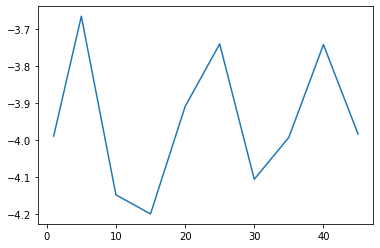

In [ ]:
import matplotlib.pyplot as plt
plt.plot(passes,coherences)
plt.show()

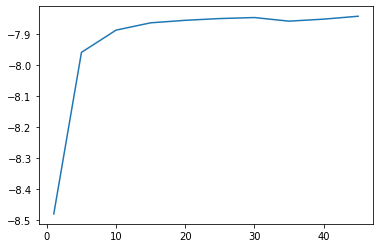

In [ ]:
plt.plot(passes,perplexities)
plt.show()  

In [ ]:
coherencesT=[]
perplexitiesT=[]
numtopic=[]
# warnings.filterwarnings('ignore')

for i in range(10):
    if i==0:
        ntopics = 2
    else:
        ntopics = 10*i
    nwords = 100
    numtopic.append(ntopics)
    tic = time.time()
    # 위 그래프에서 찾은 최적의 Passes 값을 넣어주세요
    lda4 = LdaModel(corpus, id2word=dictionary, num_topics=ntopics, iterations=400, passes=25)
    print('ntopics',ntopics,time.time() - tic)

    cm = CoherenceModel(model=lda4, corpus=corpus, coherence='u_mass')
    coherence = cm.get_coherence()
    print("Cpherence",coherence)
    coherencesT.append(coherence)
    print('Perplexity: ', lda4.log_perplexity(corpus),'\n\n')
    perplexitiesT.append(lda4.log_perplexity(corpus))

Output hidden; open in https://colab.research.google.com to view.

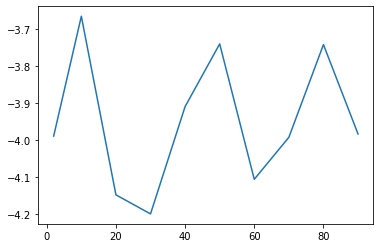

In [ ]:
# 그래프 그리기
import matplotlib.pyplot as plt
plt.plot(numtopic,coherences)
plt.show()

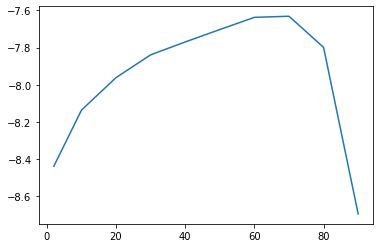

In [ ]:
import matplotlib.pyplot as plt
plt.plot(numtopic,perplexitiesT)
plt.show()

In [ ]:
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.decomposition import LatentDirichletAllocation

#LDA 는 Count기반의 Vectorizer만 적용 
count_vectorizer = CountVectorizer(max_df=0.1, max_features=1000, min_df=1, ngram_range=(1,2))

feat_vect = count_vectorizer.fit_transform(data.clean_words)
print('CountVectorizer Shape:', feat_vect.shape)

CountVectorizer Shape: (2977, 1000)


In [ ]:
from sklearn.decomposition import LatentDirichletAllocation, TruncatedSVD
from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer
from sklearn.model_selection import GridSearchCV
from pprint import pprint

# 위에서 찾은 토픽 개수를 n_components에 넣어주세요
# 다른 건 바꾸지 마세요
lda = LatentDirichletAllocation(n_components = 50, max_iter = 10, learning_decay = 0.9, random_state = 42)
lda.fit(feat_vect)

LatentDirichletAllocation(batch_size=128, doc_topic_prior=None,
                          evaluate_every=-1, learning_decay=0.9,
                          learning_method='batch', learning_offset=10.0,
                          max_doc_update_iter=100, max_iter=10,
                          mean_change_tol=0.001, n_components=50, n_jobs=None,
                          perp_tol=0.1, random_state=42, topic_word_prior=None,
                          total_samples=1000000.0, verbose=0)

In [ ]:
# Plotting tools
import pyLDAvis
import pyLDAvis.sklearn
import matplotlib.pyplot as plt
%matplotlib inline

In [ ]:
import pyLDAvis.sklearn  # sklearn의 ldamodel에 최적화된 라이브러리

pyLDAvis.enable_notebook()
vis = pyLDAvis.sklearn.prepare(lda, feat_vect, count_vectorizer)
pyLDAvis.display(vis)

/usr/local/lib/python3.7/dist-packages/pyLDAvis/_prepare.py:247: FutureWarning: In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only
  by='saliency', ascending=False).head(R).drop('saliency', 1)


In [ ]:
def show_topics(vectorizer, lda_model, n_words):
    keywords = np.array(vectorizer.get_feature_names())
    topic_keywords = []
    for topic_weights in lda_model.components_:
        top_keyword_locs = (-topic_weights).argsort()[:n_words]
        topic_keywords.append(keywords.take(top_keyword_locs))
    return topic_keywords

topic_keywords = show_topics(vectorizer=count_vectorizer, lda_model=lda, n_words=15)        

# Topic - Keywords Dataframe
df_topic_keywords = pd.DataFrame(topic_keywords)
df_topic_keywords.columns = ['Word '+str(i) for i in range(df_topic_keywords.shape[1])]
df_topic_keywords.index = ['Topic '+str(i) for i in range(1, df_topic_keywords.shape[0]+1)]
df_topic_keywords

,Word 0,Word 1,Word 2,Word 3,Word 4,Word 5,Word 6,Word 7,Word 8,Word 9,Word 10,Word 11,Word 12,Word 13,Word 14
Topic 1,카카오,청약,페이,카카오 페이,공모,대한항공,정비,항공기,회전,부사,예측,상장,능력,부문,향상
Topic 2,넷플릭스,테크,테슬라,엔씨소프트,상치,흥행,실적 발표,뉴욕,게임,오른,둔화,대감,소식,플러스,오른 거래
Topic 3,브랜드,온라인,소비자,롯데,매장,오프라인,백화점,신제품,구매,프리미엄,체험,오픈,구성,트렌드,공식
Topic 4,펀드,운용,입니다,연금,삼성,자산운용,수익률,퇴직,있습니다,tdf,퇴직 연금,준법,금융투자,장기,주식
Topic 5,sk,데이터,하이닉스,sk 하이닉스,사장,마이크로소프트,창업,대회,반도체,생태계,연구,it,ai,조성,변화
Topic 6,대출,주택,신용,담보,담보 대출,신용 대출,주택 담보,담대,받은,차주,비중,집계,채무자,대출 받은,집계 됐다
Topic 7,혁신,협약,유치,연구,투자 유치,업무,ai,인증,주제,스케,재판매,업무 협약,재판매 금지,금지,하나은행
Topic 8,열분해,sk,에코,트릭,플라스틱,지오,지오 트릭,sk 지오,회장,레이,남양유업,처리,에코 레이,재활용,원료
Topic 9,카드,결제,할인,혜택,골프,할부,호텔,신청,프로모션,페이,테크,인기,구매,커머스,소비자
Topic 10,반도체,애플,삼성,공장,부회장,더블,스마트폰,공정,인텔,부품,장비,강조,경영,제조,경쟁


In [ ]:
# 문서별 토픽 할당

doc_topic = lda.transform(feat_vect)

doc_per_topic_list = []
for n in range(doc_topic.shape[0]):
  topic_most_pr = doc_topic[n].argmax() +1
  topic_pr = doc_topic[n].max()
  doc_per_topic_list.append([n, topic_most_pr, topic_pr])

doc_topic_df = pd.DataFrame(doc_per_topic_list, columns = ['Doc_Num', 'Topic', 'Percentage'])

In [ ]:
data['topic'] = doc_topic_df['Topic']
data['Percentage'] = doc_topic_df['Percentage']

In [ ]:
# 저장하는 파일명 잘 확인

df_topic_keywords.to_csv('/content/drive/Shareddrives/🥑PSAT_DM_2728🥑/Dataset/토픽모델링2/경제&사회_20211019_Topics.csv', index = False, encoding = 'utf-8')
data.to_csv('/content/drive/Shareddrives/🥑PSAT_DM_2728🥑/Dataset/토픽모델링2/경제&사회_20211019_Allocation.csv', index = False, encoding = 'utf-8')

## 여기부터 복붙해서 사용

In [ ]:
data = pd.read_csv('/content/drive/Shareddrives/🥑PSAT_DM_2728🥑/Dataset/기사크롤링_TFIDF/경제&사회_20211020_TFIDF.csv', encoding = 'utf-8')

In [ ]:
data['clean_words_gensim'] = data['clean_words'].apply(lambda k: eval(''.join(k)))

In [ ]:
data["clean_words_gensim"]

0       [뉴욕, 뉴욕, 증권, 거래소, 자산운용, 사, 프로, 셰어, 시미, 하이먼, 최고...
1       [비트코인, 개당, ETF, 데뷔, 후, 최고, 뛰어넘어, 비트코인, 가격, 넘으며...
2       [오전, 선물, 흐름, 그렇고, 숨, 고르기에, 들어간, 모습, 입니다, 본격, 어...
3       [인민, 은행, 이강, 행, 기한, 맞은, 채권, 이자, 연달, 지급, 채무불이행,...
4       [뉴욕, 증권, 거래소, 강민경, 뉴욕증시, 상승세, 출발, 다우존스, 산업, 평균...
                              ...                        
3038    [러시아, 인도, 펀드, 고공, 행진, 개월새, 에너지, 강세, 부진, 흔들리는, ...
3039    [동부, 오전, 개장, 대형, 내놓은, 실적, 대체로, 시장, 예상, 넘어서면서, ...
3040    [디, 피씨, PEF, 운용, 사, 스틱, 흡수, 합병, 결정, 자산, 육박, PE...
3041    [자체, 분, 매입, 마, 이스터, PE, 분, 콜, 옵션, 확보, 하이파, 킹, ...
3042    [사모펀드, PEF, 운용, 사, MBK, 파트너, 스, 인수, 라이프, 스타일, ...
Name: clean_words_gensim, Length: 3043, dtype: object

In [ ]:
import pandas as pd
import numpy as np
import re
# import coredottext.nlp as nlp
import json
import warnings
# import pyLDAvis.gensim
from gensim.models.coherencemodel import CoherenceModel
from gensim.models.ldamodel import LdaModel
from gensim.corpora.dictionary import Dictionary
from gensim import corpora
import time

In [ ]:
# 문서를 사전 형식으로 만들기
tokenized_doc=data["clean_words_gensim"]
dictionary = corpora.Dictionary(tokenized_doc)
corpus = [dictionary.doc2bow(text) for text in tokenized_doc]
# 두번째 뉴스 결과 출력: (단어의 정수, 단어의 빈도 수)
print(corpus[1])

[(0, 6), (2, 6), (3, 2), (6, 1), (7, 2), (19, 1), (23, 1), (31, 13), (34, 3), (36, 3), (37, 1), (38, 1), (39, 1), (40, 1), (47, 1), (53, 1), (54, 3), (58, 1), (60, 1), (66, 5), (70, 1), (71, 2), (72, 1), (73, 3), (74, 1), (79, 1), (80, 1), (81, 1), (82, 1), (83, 1), (84, 1), (85, 1), (86, 2), (87, 1), (88, 1), (89, 1), (90, 1), (91, 2), (92, 1), (93, 1), (94, 1), (95, 1), (96, 3), (97, 2), (98, 1), (99, 2), (100, 1), (101, 1), (102, 1), (103, 1), (104, 1), (105, 1), (106, 1), (107, 1), (108, 1), (109, 1), (110, 1), (111, 3), (112, 1), (113, 1), (114, 3), (115, 1), (116, 2), (117, 1), (118, 1), (119, 2), (120, 1), (121, 1), (122, 1), (123, 6), (124, 1), (125, 1), (126, 1), (127, 1), (128, 1), (129, 1), (130, 1), (131, 1), (132, 1), (133, 1), (134, 1), (135, 3), (136, 1), (137, 1), (138, 1), (139, 1), (140, 1), (141, 1), (142, 1), (143, 1), (144, 1), (145, 1), (146, 1), (147, 1), (148, 3), (149, 2), (150, 1), (151, 1), (152, 1), (153, 1), (154, 1), (155, 4), (156, 1)]


In [ ]:
# coherences: 상위 단어들간 유사도: 해당주제와 얼마나 의미론적으로 일치하는 단어들이 모여있는지.
# perplexity: 혼란도: 실제로 관측되는 값을 얼마나 잘 예측하는지. 작을수록 좋음!
# coherence를 두단어간 조합으로 검사를 하되, 한 단어가 다른 단어와 다른 문서들에서 얼마나 많이 쓰였는지 frequency를 검사.
coherences=[]
perplexities=[]
passes=[]
# warnings.filterwarnings('ignore')
# passes tuning
for i in range(10):
    ntopics, nwords = 30, 1000
    if i==0:
        p=1
    else:
        p=i*5
    passes.append(p)
    tic = time.time()
    lda4 = LdaModel(corpus, id2word=dictionary, num_topics=ntopics, iterations=400, passes=p)
    print('epoch',p,time.time() - tic)

    cm = CoherenceModel(model=lda4, corpus=corpus, coherence='u_mass')
    coherence = cm.get_coherence()
    print("Coherence",coherence)
    coherences.append(coherence)
    print('Perplexity: ', lda4.log_perplexity(corpus),'\n\n')
    perplexities.append(lda4.log_perplexity(corpus))

Output hidden; open in https://colab.research.google.com to view.

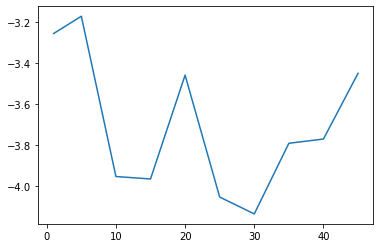

In [ ]:
import matplotlib.pyplot as plt
plt.plot(passes,coherences)
plt.show()

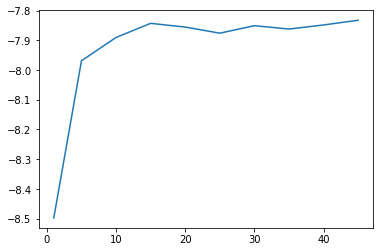

In [ ]:
plt.plot(passes,perplexities)
plt.show()  

In [ ]:
coherencesT=[]
perplexitiesT=[]
numtopic=[]
# warnings.filterwarnings('ignore')

for i in range(10):
    if i==0:
        ntopics = 2
    else:
        ntopics = 10*i
    nwords = 100
    numtopic.append(ntopics)
    tic = time.time()
    # 위 그래프에서 찾은 최적의 Passes 값을 넣어주세요
    lda4 = LdaModel(corpus, id2word=dictionary, num_topics=ntopics, iterations=400, passes=20)
    print('ntopics',ntopics,time.time() - tic)

    cm = CoherenceModel(model=lda4, corpus=corpus, coherence='u_mass')
    coherence = cm.get_coherence()
    print("Cpherence",coherence)
    coherencesT.append(coherence)
    print('Perplexity: ', lda4.log_perplexity(corpus),'\n\n')
    perplexitiesT.append(lda4.log_perplexity(corpus))

Output hidden; open in https://colab.research.google.com to view.

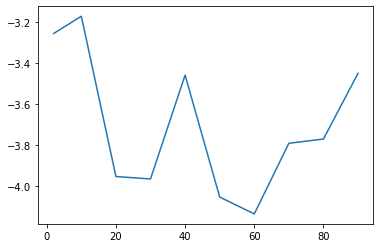

In [ ]:
# 그래프 그리기
import matplotlib.pyplot as plt
plt.plot(numtopic,coherences)
plt.show()

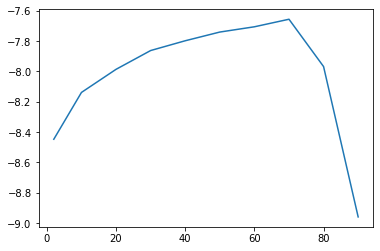

In [ ]:
import matplotlib.pyplot as plt
plt.plot(numtopic,perplexitiesT)
plt.show()

In [ ]:
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.decomposition import LatentDirichletAllocation

#LDA 는 Count기반의 Vectorizer만 적용 
count_vectorizer = CountVectorizer(max_df=0.1, max_features=1000, min_df=1, ngram_range=(1,2))

feat_vect = count_vectorizer.fit_transform(data.clean_words)
print('CountVectorizer Shape:', feat_vect.shape)

CountVectorizer Shape: (3043, 1000)


In [ ]:
from sklearn.decomposition import LatentDirichletAllocation, TruncatedSVD
from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer
from sklearn.model_selection import GridSearchCV
from pprint import pprint

# 위에서 찾은 토픽 개수를 n_components에 넣어주세요
# 다른 건 바꾸지 마세요
lda = LatentDirichletAllocation(n_components = 40, max_iter = 10, learning_decay = 0.9, random_state = 42)
lda.fit(feat_vect)

LatentDirichletAllocation(batch_size=128, doc_topic_prior=None,
                          evaluate_every=-1, learning_decay=0.9,
                          learning_method='batch', learning_offset=10.0,
                          max_doc_update_iter=100, max_iter=10,
                          mean_change_tol=0.001, n_components=40, n_jobs=None,
                          perp_tol=0.1, random_state=42, topic_word_prior=None,
                          total_samples=1000000.0, verbose=0)

In [ ]:
# Plotting tools
import pyLDAvis
import pyLDAvis.sklearn
import matplotlib.pyplot as plt
%matplotlib inline

In [ ]:
import pyLDAvis.sklearn  # sklearn의 ldamodel에 최적화된 라이브러리

pyLDAvis.enable_notebook()
vis = pyLDAvis.sklearn.prepare(lda, feat_vect, count_vectorizer)
pyLDAvis.display(vis)

/usr/local/lib/python3.7/dist-packages/pyLDAvis/_prepare.py:247: FutureWarning: In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only
  by='saliency', ascending=False).head(R).drop('saliency', 1)


In [ ]:
def show_topics(vectorizer, lda_model, n_words):
    keywords = np.array(vectorizer.get_feature_names())
    topic_keywords = []
    for topic_weights in lda_model.components_:
        top_keyword_locs = (-topic_weights).argsort()[:n_words]
        topic_keywords.append(keywords.take(top_keyword_locs))
    return topic_keywords

topic_keywords = show_topics(vectorizer=count_vectorizer, lda_model=lda, n_words=15)        

# Topic - Keywords Dataframe
df_topic_keywords = pd.DataFrame(topic_keywords)
df_topic_keywords.columns = ['Word '+str(i) for i in range(df_topic_keywords.shape[1])]
df_topic_keywords.index = ['Topic '+str(i) for i in range(1, df_topic_keywords.shape[0]+1)]
df_topic_keywords

,Word 0,Word 1,Word 2,Word 3,Word 4,Word 5,Word 6,Word 7,Word 8,Word 9,Word 10,Word 11,Word 12,Word 13,Word 14
Topic 1,솔루션,에너지,lg,에너지 솔루션,lg 에너지,배터리,과정,프라,국민은행,학과,인재,인력,인수,kb,융합
Topic 2,협약,협회,체결,금융 상품,업무 협약,업무,선박,소비자,자율,케이,스마트,공시,채용,협력,방법
Topic 3,오른,포인트,외국인,매수,매도,강세,마쳤다,상승세,종목,전일,거래 대비,올랐다,개인,연속,오른 거래
Topic 4,소재,수출,국산,항공,전시회,첨단,국제,전시,참가,미래,해외,신흥,분야,kai,수입
Topic 5,백신,접종,발사,누리,우주,백신 접종,한화,스페이스,위성,방역,러시아,위드,위드 코로나,회복,완료
Topic 6,바이오,치료,발행,채권,소재,환자,조성,조달,신약,시험,친환경,물질,그린,주택,시설
Topic 7,기능,디자인,테크,페이스북,시스템,메타,버스,메타 버스,세대,소비자,시대,변화,데이터,공간,사용자
Topic 8,영상,제보,국채,언론,화제,또는,공감,있다고 판단,상부,판단 되는,소중한,적극 반영,독자,하겠습니다,보내주시면 적극
Topic 9,롯데,행사,카드,할인,결제,백화점,신세계,구매,수수료,브랜드,매장,이마트,해외,가맹,혜택
Topic 10,선정,kt,차량,안전,gv,주행,suv,모터,트렌드,대한항공,사업자,공사,의무,성능,독점


In [ ]:
# 문서별 토픽 할당

doc_topic = lda.transform(feat_vect)

doc_per_topic_list = []
for n in range(doc_topic.shape[0]):
  topic_most_pr = doc_topic[n].argmax() +1
  topic_pr = doc_topic[n].max()
  doc_per_topic_list.append([n, topic_most_pr, topic_pr])

doc_topic_df = pd.DataFrame(doc_per_topic_list, columns = ['Doc_Num', 'Topic', 'Percentage'])

In [ ]:
data['topic'] = doc_topic_df['Topic']
data['Percentage'] = doc_topic_df['Percentage']

In [ ]:
# 저장하는 파일명 잘 확인

df_topic_keywords.to_csv('/content/drive/Shareddrives/🥑PSAT_DM_2728🥑/Dataset/토픽모델링2/경제&사회_20211020_Topics.csv', index = False, encoding = 'utf-8')
data.to_csv('/content/drive/Shareddrives/🥑PSAT_DM_2728🥑/Dataset/토픽모델링2/경제&사회_20211020_Allocation.csv', index = False, encoding = 'utf-8')